<a href="https://colab.research.google.com/github/Zarathustra616/CV-and-ML/blob/main/hw1_tasks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Геморное домашнее задание №1

<img src='https://i0.wp.com/media4.giphy.com/media/AlBHDuku3H7fG/giphy.gif'><br>

# Загрузка данных

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        
        
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split

In [ ]:
train = pd.read_csv('train.csv', sep=';')
test = pd.read_csv('test.csv', sep=';')
submission = pd.read_csv('sample_submission.csv')

In [ ]:
'train: ', train.shape, 'test: ', test.shape

('train: ', (39481, 15), 'test: ', (9871, 14))

Результат нужно сохранить в **csv файл с двумя колонками**: 

listing_id - берете из датасета

interest_level - проставляете своим алгоритмом

Разделитель **запятая**, при сохранении с помощью result.to_csv() - не забывайте указывать index=None.

In [ ]:
submission.head()

,listing_id,interest_level
0,7077863,0
1,7089371,0
2,7210791,0
3,6817348,0
4,7149366,0


## Анализ данных
## 1. Предобработка и генерация признаков

Для выполнения задания попробуйте придумать признаки на основе имеющихся данных, для работы с текстовыми полями вам может пригодится LabelEncoder/OneHotEncoder, re.sub(),re.findall() 

Ниже представлены имеющиеся у нас признаки. Можно попробовать сгенерировать из них новые. Например, можно сделать признак Стоимость за комнату, признаки на основе значений в features, выделить и закодировать адрес, так же можно попробовать оценить "успешность" менеджера, предположив, что чем больше объявлений у данного manager_id - тем он круче.

In [ ]:
train.columns

Index(['bathrooms', 'bedrooms', 'building_id', 'created', 'description',
       'display_address', 'features', 'latitude', 'listing_id', 'longitude',
       'manager_id', 'photos', 'price', 'street_address', 'interest_level'],
      dtype='object')

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39481 entries, 0 to 39480
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   bathrooms        39481 non-null  float64
 1   bedrooms         39481 non-null  int64  
 2   building_id      39481 non-null  object 
 3   created          39481 non-null  object 
 4   description      38337 non-null  object 
 5   display_address  39376 non-null  object 
 6   features         39481 non-null  object 
 7   latitude         39481 non-null  float64
 8   listing_id       39481 non-null  int64  
 9   longitude        39481 non-null  float64
 10  manager_id       39481 non-null  object 
 11  photos           39481 non-null  object 
 12  price            39481 non-null  int64  
 13  street_address   39472 non-null  object 
 14  interest_level   39481 non-null  object 
dtypes: float64(3), int64(3), object(9)
memory usage: 4.5+ MB


In [ ]:
train.bathrooms=train.bathrooms.astype('int')

In [ ]:
train.head()

,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,interest_level
0,1,0,cb0ecd5356125b546833239efdb154c2,2016-06-02 04:21:46,AMAZING STUDIO!! CONVENIENT TO ALL - G...,Gold Street,"['Cats Allowed', 'Dogs Allowed']",40.6969,7097709,-73.9830,79d1809d224bc7f26c719f247d6c8dc6,['https://photos.renthop.com/2/7097709_8f74305...,2575,257 Gold Street,low
1,1,2,4df46d9768a98df24200a2e7693370bd,2016-05-26 05:44:12,"Near NYU, Washington SQ Park, centrally locate...",Thompson Street,[],40.7264,7071860,-74.0013,e60b02e0cfd2eea7d777bb283d6f8d4d,['https://photos.renthop.com/2/7071860_32b196a...,3250,128 Thompson Street,high
2,1,0,0,2016-06-17 01:22:32,RENT STABILIZED! FULL TIME DOORMAN.LEXINGTON A...,East 35th Street,"['Doorman', 'Dogs Allowed', 'Cats Allowed']",40.7466,7174524,-73.9779,91a276fdb4c7ae5ff56fd0884b5121db,['https://photos.renthop.com/2/7174524_bde8df9...,2448,165 East 35th Street,low
3,1,1,78e50c94b33bb1ceeb5f4c8ff7455703,2016-06-03 05:26:40,WHY TO LIVE IN THIS LUXURIOUS BUILDING? WEEKDA...,West 42nd Street,"['Swimming Pool', 'Roof Deck', 'Dining Room', ...",40.7610,7104515,-73.9992,cbcd513212d592e6c717d27be14f46ac,['https://photos.renthop.com/2/7104515_bab0753...,3300,610 West 42nd Street,low
4,2,0,e87f1236b102798c1fa104a372800444,2016-04-12 04:10:28,Listed on the National Register of His...,Greenwich Street,"['Doorman', 'Fitness Center', 'No Fee']",40.7324,6859942,-74.0081,b209e2c4384a64cc307c26759ee0c651,['https://photos.renthop.com/2/6859942_16f88f7...,5450,666 Greenwich Street,low


In [ ]:
train.interest_level.value_counts()

low       27446
medium     8941
high       3094
Name: interest_level, dtype: int64

In [ ]:
train.interest_level.value_counts(normalize=True)

low       0.695170
medium    0.226463
high      0.078367
Name: interest_level, dtype: float64

**Строки превращаем обратно в список**

In [ ]:
train['are_animals_allowed'] = train.features.apply(lambda feature_list : 'Cats Allowed' in feature_list or 'Dogs Allowed' in feature_list)

Признак можно ли заселяться с животными. Т.к. Cats Allowed и Dogs Allowed самые распространенные из features

In [ ]:
train.head()

,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,interest_level,are_animals_allowed
0,1,0,cb0ecd5356125b546833239efdb154c2,2016-06-02 04:21:46,AMAZING STUDIO!! CONVENIENT TO ALL - G...,Gold Street,"['Cats Allowed', 'Dogs Allowed']",40.6969,7097709,-73.9830,79d1809d224bc7f26c719f247d6c8dc6,['https://photos.renthop.com/2/7097709_8f74305...,2575,257 Gold Street,low,True
1,1,2,4df46d9768a98df24200a2e7693370bd,2016-05-26 05:44:12,"Near NYU, Washington SQ Park, centrally locate...",Thompson Street,[],40.7264,7071860,-74.0013,e60b02e0cfd2eea7d777bb283d6f8d4d,['https://photos.renthop.com/2/7071860_32b196a...,3250,128 Thompson Street,high,False
2,1,0,0,2016-06-17 01:22:32,RENT STABILIZED! FULL TIME DOORMAN.LEXINGTON A...,East 35th Street,"['Doorman', 'Dogs Allowed', 'Cats Allowed']",40.7466,7174524,-73.9779,91a276fdb4c7ae5ff56fd0884b5121db,['https://photos.renthop.com/2/7174524_bde8df9...,2448,165 East 35th Street,low,True
3,1,1,78e50c94b33bb1ceeb5f4c8ff7455703,2016-06-03 05:26:40,WHY TO LIVE IN THIS LUXURIOUS BUILDING? WEEKDA...,West 42nd Street,"['Swimming Pool', 'Roof Deck', 'Dining Room', ...",40.7610,7104515,-73.9992,cbcd513212d592e6c717d27be14f46ac,['https://photos.renthop.com/2/7104515_bab0753...,3300,610 West 42nd Street,low,False
4,2,0,e87f1236b102798c1fa104a372800444,2016-04-12 04:10:28,Listed on the National Register of His...,Greenwich Street,"['Doorman', 'Fitness Center', 'No Fee']",40.7324,6859942,-74.0081,b209e2c4384a64cc307c26759ee0c651,['https://photos.renthop.com/2/6859942_16f88f7...,5450,666 Greenwich Street,low,False


In [ ]:
train.features

0                         ['Cats Allowed', 'Dogs Allowed']
1                                                       []
2              ['Doorman', 'Dogs Allowed', 'Cats Allowed']
3        ['Swimming Pool', 'Roof Deck', 'Dining Room', ...
4                  ['Doorman', 'Fitness Center', 'No Fee']
                               ...                        
39476                     ['Dogs Allowed', 'Cats Allowed']
39477    ['Swimming Pool', 'Doorman', 'Elevator', 'Fitn...
39478                       ['Elevator', 'Fitness Center']
39479    ['Pre-War', 'Laundry in Unit', 'Dishwasher', '...
39480    ['Doorman', 'Fitness Center', 'Elevator', 'Sto...
Name: features, Length: 39481, dtype: object

In [ ]:
train['features']=train['features'].str.replace('[\[\]\']', '').str.split(', ')

<ipython-input-598-118b910e5b18>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  train['features']=train['features'].str.replace('[\[\]\']', '').str.split(', ')


In [ ]:
train['features']

0                             [Cats Allowed, Dogs Allowed]
1                                                       []
2                    [Doorman, Dogs Allowed, Cats Allowed]
3        [Swimming Pool, Roof Deck, Dining Room, Doorma...
4                        [Doorman, Fitness Center, No Fee]
                               ...                        
39476                         [Dogs Allowed, Cats Allowed]
39477    [Swimming Pool, Doorman, Elevator, Fitness Cen...
39478                           [Elevator, Fitness Center]
39479    [Pre-War, Laundry in Unit, Dishwasher, Hardwoo...
39480    [Doorman, Fitness Center, Elevator, Storage, P...
Name: features, Length: 39481, dtype: object

In [ ]:
train['num_features']=train['features'].apply(len)

In [ ]:
train.head()

,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,interest_level,are_animals_allowed,num_features
0,1,0,cb0ecd5356125b546833239efdb154c2,2016-06-02 04:21:46,AMAZING STUDIO!! CONVENIENT TO ALL - G...,Gold Street,"[Cats Allowed, Dogs Allowed]",40.6969,7097709,-73.9830,79d1809d224bc7f26c719f247d6c8dc6,['https://photos.renthop.com/2/7097709_8f74305...,2575,257 Gold Street,low,True,2
1,1,2,4df46d9768a98df24200a2e7693370bd,2016-05-26 05:44:12,"Near NYU, Washington SQ Park, centrally locate...",Thompson Street,[],40.7264,7071860,-74.0013,e60b02e0cfd2eea7d777bb283d6f8d4d,['https://photos.renthop.com/2/7071860_32b196a...,3250,128 Thompson Street,high,False,1
2,1,0,0,2016-06-17 01:22:32,RENT STABILIZED! FULL TIME DOORMAN.LEXINGTON A...,East 35th Street,"[Doorman, Dogs Allowed, Cats Allowed]",40.7466,7174524,-73.9779,91a276fdb4c7ae5ff56fd0884b5121db,['https://photos.renthop.com/2/7174524_bde8df9...,2448,165 East 35th Street,low,True,3
3,1,1,78e50c94b33bb1ceeb5f4c8ff7455703,2016-06-03 05:26:40,WHY TO LIVE IN THIS LUXURIOUS BUILDING? WEEKDA...,West 42nd Street,"[Swimming Pool, Roof Deck, Dining Room, Doorma...",40.7610,7104515,-73.9992,cbcd513212d592e6c717d27be14f46ac,['https://photos.renthop.com/2/7104515_bab0753...,3300,610 West 42nd Street,low,False,16
4,2,0,e87f1236b102798c1fa104a372800444,2016-04-12 04:10:28,Listed on the National Register of His...,Greenwich Street,"[Doorman, Fitness Center, No Fee]",40.7324,6859942,-74.0081,b209e2c4384a64cc307c26759ee0c651,['https://photos.renthop.com/2/6859942_16f88f7...,5450,666 Greenwich Street,low,False,3


Фотографии можно спарсить по ссылкам, но т.к. обработка изображений в этой домашке не в приоритете, можно просто посчитать количество фотографий.

In [ ]:
train['photos']=train['photos'].str.replace('[\[\]\']', '').str.split(', ')
train['num_photos']=train['photos'].apply(len)

<ipython-input-602-8466bba9b071>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  train['photos']=train['photos'].str.replace('[\[\]\']', '').str.split(', ')


Делаем самые простые фичи. В данном случае просто считаем кол-во слов в описании.

В датасете присутствуют NaN, поэтому предварительно заполняем пропуски пустыми строками.

In [ ]:
train["num_description_words"]=train["description"].fillna('').apply(lambda x: len(x.split(" ")))

Может быть заинтересованность объявлением зависит от времени года или времени публикации?

In [ ]:
train["created"]

0        2016-06-02 04:21:46
1        2016-05-26 05:44:12
2        2016-06-17 01:22:32
3        2016-06-03 05:26:40
4        2016-04-12 04:10:28
                ...         
39476    2016-06-20 18:09:47
39477    2016-04-26 05:40:27
39478    2016-04-10 03:20:09
39479    2016-06-03 03:53:35
39480    2016-06-15 02:29:10
Name: created, Length: 39481, dtype: object

In [ ]:
train["created"] = pd.to_datetime(train["created"])
train["created_year"] = train["created"].dt.year
train["created_month"] = train["created"].dt.month
train["created_day"] = train["created"].dt.day
train["created_hour"] = train["created"].dt.hour

<AxesSubplot:xlabel='index'>

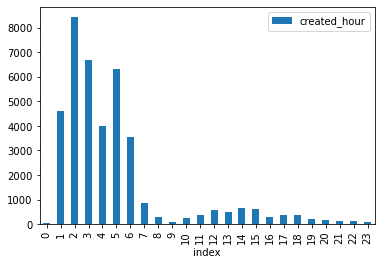

In [ ]:
hours=train["created_hour"].value_counts().reset_index().sort_values(by='index')
hours.plot(x='index', y='created_hour', kind='bar')

не похоже что стоит использовать created_month в модели

<AxesSubplot:xlabel='index'>

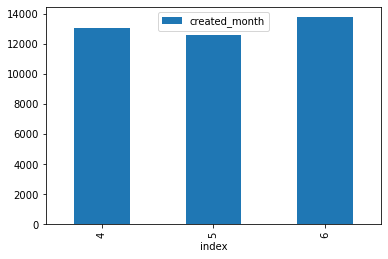

In [ ]:
months=train["created_month"].value_counts().reset_index().sort_values(by='index')
months.plot(x='index', y='created_month', kind='bar')

<AxesSubplot:xlabel='index'>

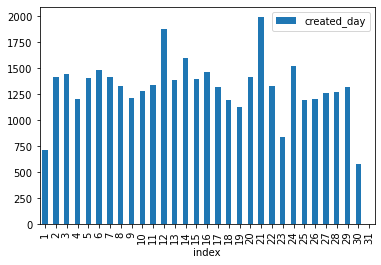

In [ ]:
months=train["created_day"].value_counts().reset_index().sort_values(by='index')
months.plot(x='index', y='created_day', kind='bar')

<AxesSubplot:ylabel='price'>

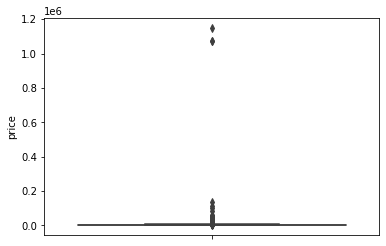

In [ ]:
import seaborn as sns
sns.boxplot(y='price', data=train)

Проверка выбросов по цене, в датасете присутствуют выбросы

In [ ]:
train.sort_values (by='price', ascending=False).head(395)

,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,...,street_address,interest_level,are_animals_allowed,num_features,num_photos,num_description_words,created_year,created_month,created_day,created_hour
14373,1,2,5d3525a5085445e7fcd64a53aac3cb0a,2016-06-24 05:02:58,NaN,West 116th Street,"[Doorman, Elevator, Cats Allowed, Dogs Allowed...",40.8011,7208794,-73.9480,...,40 West 116th Street,low,True,5,1,1,2016,6,24,5
6643,1,1,37385c8a58176b529964083315c28e32,2016-05-19 02:37:06,This 1 Bedroom apartment is located on a prime...,West 57th Street,"[Doorman, Elevator, Pre-War, Dogs Allowed, Cat...",40.7676,7036279,-73.9844,...,333 West 57th Street,low,True,5,7,137,2016,5,19,2
26601,1,1,37385c8a58176b529964083315c28e32,2016-05-14 05:21:28,,West 57th Street,"[Doorman, Cats Allowed, Dogs Allowed]",40.7676,7013217,-73.9844,...,333 West 57th Street,low,True,3,1,9,2016,5,14,5
7012,0,0,b9c72643feb2652536a898a5f13d2543,2016-04-12 02:11:10,"Originally built in 1862, this extraordinary l...",Duane Street,"[Elevator, Pre-War, Terrace, Dogs Allowed, Cat...",40.7161,6857401,-74.0080,...,144 Duane Street,low,True,5,20,274,2016,4,12,2
7990,1,0,c0d27c9422c375c651baa7b61e4a9dca,2016-06-07 17:35:10,The BEST DEAL!!!!!\r\rBeautiful Studio in a ni...,Van Horn St and 57th ave,"[Elevator, Laundry In Building, Balcony]",40.7323,7122037,-73.8761,...,57-25 Van Horn St,high,False,3,1,81,2016,6,7,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31017,3,3,84ababccac27ba73d403bd968d1f3bec,2016-06-14 15:54:09,Perfect UWS location near Central Park & Linco...,Broadway,"[Swimming Pool, Dining Room, Doorman, Elevator...",40.7725,7160297,-73.9819,...,1930 Broadway,low,False,10,6,199,2016,6,14,15
20493,2,2,65ce068d10ade85cc097134c0f6836c2,2016-05-18 07:21:29,Stunning high floor two bedroom / two bathroom...,W 62 St.,"[Dining Room, Doorman, Elevator, Loft, Laundry...",40.7721,7032768,-73.9861,...,160 W 62 St.,low,False,9,6,66,2016,5,18,7
20550,3,5,0,2016-04-03 03:51:43,"Stunning penthouse 3br with amazing views, spr...",East 87th Street,"[Swimming Pool, Roof Deck, Dining Room, Doorma...",40.7886,6819362,-73.9748,...,201 East 87th Street,low,False,11,3,105,2016,4,3,3
27218,3,4,3c447815d39ae148e5163b1ad6b36cb6,2016-04-24 03:10:55,<p><a website_redacted,W 80th St.,"[Dining Room, Doorman, Elevator, Laundry in Bu...",40.7827,6918810,-73.9753,...,100 W 80th St.,low,False,6,9,4,2016,4,24,3


Сортировка 1% датасета по цене, здесь видно, что максимум цены у большинства квартир 13000, удаляем всё что больше

In [ ]:
train=train[train['price']<=13000]
train=train[train['price']!=0]

<AxesSubplot:ylabel='price'>

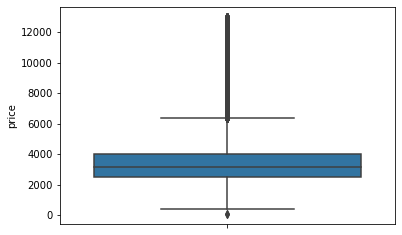

In [ ]:
sns.boxplot(y='price', data=train)

<AxesSubplot:xlabel='longitude', ylabel='latitude'>

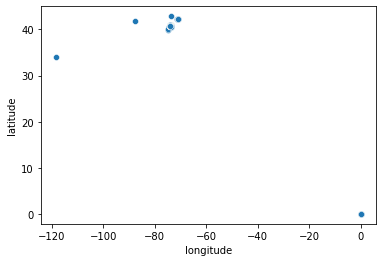

In [ ]:
sns.scatterplot(x='longitude', y='latitude', data=train)

In [ ]:
Проверка выбросов по широте и долготе, присутствуют выбросы

SyntaxError: invalid syntax (<ipython-input-614-fba5b388c522>, line 1)

In [ ]:
#Latitude выбросы
left_outliers = np.percentile(train['latitude'], 0.5)
right_outliers = np.percentile(train['latitude'], 99.5)

train['latitude'].loc[train['latitude'] > right_outliers] = right_outliers
train['latitude'].loc[train['latitude'] < left_outliers] = left_outliers

#Longitude выбросы
left_outliers = np.percentile(train['longitude'], 0.5)
right_outliers = np.percentile(train['longitude'], 99.5)

train['longitude'].loc[train['longitude'] > right_outliers] = right_outliers
train['longitude'].loc[train['longitude'] < left_outliers] = left_outliers

C:\Users\nikit\anaconda3\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
C:\Users\nikit\anaconda3\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
C:\Users\nikit\anaconda3\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<AxesSubplot:xlabel='longitude', ylabel='latitude'>

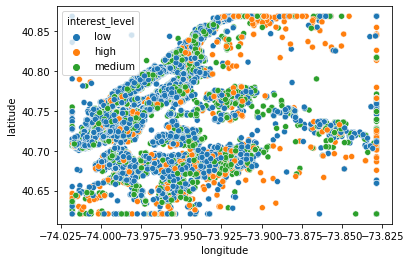

In [ ]:
sns.scatterplot(data=train, x='longitude', y='latitude', hue='interest_level')

In [ ]:
mapper={
        'low':0,
        'medium':1,
        'high':2
       }

train['interest_level'] = train['interest_level'].replace(mapper)

In [ ]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import folium

train['marker_color'] = pd.cut(train['interest_level'], bins=3, 
                              labels=['yellow', 'green', 'blue'])

m = folium.Map(location=[train['latitude'].mean(),train['longitude'].mean()],zoom_start=12)

train.apply(lambda row:folium.CircleMarker(location=[row['latitude'], 
                                                  row['longitude']],
                                           color=row['marker_color']).add_to(m),
         axis=1)

0        <folium.vector_layers.CircleMarker object at 0...
1        <folium.vector_layers.CircleMarker object at 0...
2        <folium.vector_layers.CircleMarker object at 0...
3        <folium.vector_layers.CircleMarker object at 0...
4        <folium.vector_layers.CircleMarker object at 0...
                               ...                        
39476    <folium.vector_layers.CircleMarker object at 0...
39477    <folium.vector_layers.CircleMarker object at 0...
39478    <folium.vector_layers.CircleMarker object at 0...
39479    <folium.vector_layers.CircleMarker object at 0...
39480    <folium.vector_layers.CircleMarker object at 0...
Length: 39096, dtype: object

In [ ]:
m

Была создана карта горада с размещением квартир каждого типа

In [ ]:
pip install geopy

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import geopy.distance

coords_cp = (40.785091, -73.968285)

distance = pd.DataFrame(columns=['distance_cp'], index=range(len(train)))

for i in range(len(train)):
  location=(train.iloc[i]['latitude'],train.iloc[i]['longitude'])
  distance.iloc[i]['distance_cp']=geopy.distance.distance(coords_cp,location ).km
    
train['distance_cp']=distance['distance_cp']

In [ ]:
train['distance_cp']=train['distance_cp'].astype('float')
train['distance_cp'].head()

0    9.872065
1    7.088838
2    4.350811
3    3.737511
4    6.748399
Name: distance_cp, dtype: float64

Так как вокруг центрального парка много квартир low было решено сделать признак удаленности от центрального парка

In [ ]:
train['rooms_price'] = train['price']/(train['bedrooms']+train['bathrooms'])

Признак цена за комнату

In [ ]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
train['manager_id'] = le.fit_transform(train['manager_id'])
train['street_address'] = train['street_address'].apply(lambda x: str(x))
train['street_address'] = le.fit_transform(train['street_address'])

Кодирование manager_id и street_address

In [ ]:
train['are_animals_allowed'] = train['are_animals_allowed'].astype('int')

<AxesSubplot:>

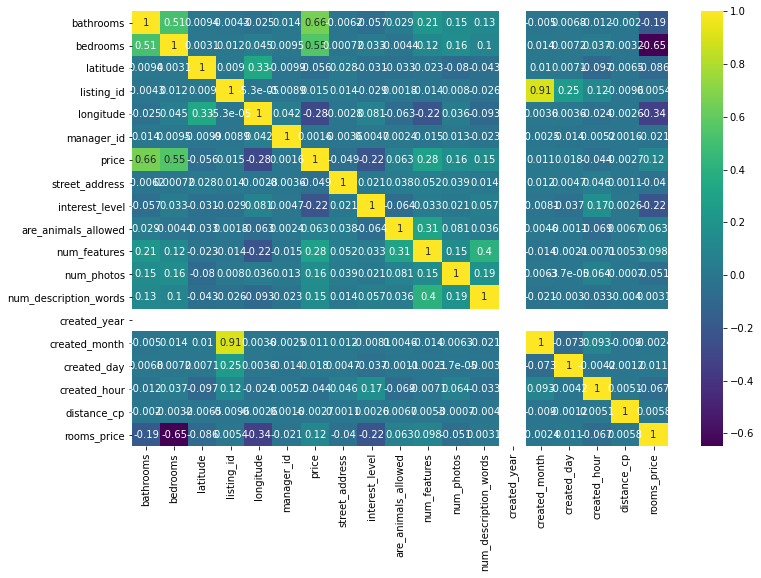

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12,8))
sns.heatmap(train.corr(),  cmap = 'viridis',annot = True)

In [ ]:
train.drop(train.columns.difference(['bathrooms','bedrooms', 'latitude',
                                     'longitude','manager_id','price','street_address',
                                    'rooms_price','interest_level','are_animals_allowed',
                                   'created_hour','created_day','num_features',
                                    'num_photos','distance_cp']), 1, inplace=True)

In [ ]:
train['distance_cp']=train['distance_cp'].fillna(train['distance_cp'].mean())

In [ ]:
train.replace([np.inf, -np.inf], np.nan, inplace=True)

In [ ]:
train['rooms_price']=train['rooms_price'].fillna(train['rooms_price'].mean())

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 39096 entries, 0 to 39480
Data columns (total 14 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   bathrooms            39096 non-null  int32  
 1   bedrooms             39096 non-null  int64  
 2   latitude             39096 non-null  float64
 3   longitude            39096 non-null  float64
 4   manager_id           39096 non-null  int32  
 5   price                39096 non-null  int64  
 6   street_address       39096 non-null  int32  
 7   interest_level       39096 non-null  int64  
 8   are_animals_allowed  39096 non-null  int32  
 9   num_features         39096 non-null  int64  
 10  num_photos           39096 non-null  int64  
 11  created_day          39096 non-null  int64  
 12  created_hour         39096 non-null  int64  
 13  rooms_price          39096 non-null  float64
dtypes: float64(3), int32(4), int64(7)
memory usage: 3.9 MB


## 2. Тестирование различных алгоритмов

Для выполнения этой части задания разбейте размеченные данные на train и test и напишите автоматическое тестирование разных алгоритмов классификации в цикле с вычислением метрики f1_score('macro')

Метрику на тесте по разным алгоритмам сохраняйте в датафрейм или выводите

In [ ]:
from sklearn.model_selection import train_test_split, StratifiedKFold, RandomizedSearchCV
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, average_precision_score
import joblib

In [ ]:
from sklearn.model_selection import train_test_split



Y=train['interest_level']
X=train.drop ('interest_level',axis=1) 
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test  = train_test_split(X, Y, test_size = 0.3, random_state = 100)


Изменяйте параметры алгоритмов на свое усмотрение, можете добавлять свои алгоритмы

In [ ]:
classifiers = {
    'KNeighborsClassifier': KNeighborsClassifier(n_neighbors = 10),
    'DecisionTreeClassifier': DecisionTreeClassifier(),
    'RandomForestClassifier': RandomForestClassifier(),
    'MLPClassifier': MLPClassifier(),
    'AdaBoostClassifier': AdaBoostClassifier(n_estimators=300),
    'GaussianNB': GaussianNB(),
    'QuadraticDiscriminantAnalysis': QuadraticDiscriminantAnalysis(),
    'XGBClassifier': XGBClassifier(objective="multi:softprob", max_depth=9),
    'LogisticRegression': LogisticRegression(multi_class='multinomial'),

}

In [ ]:
for name, model in classifiers.items():
    print(name)
    
    model.fit(X_train, Y_train)
    y_pred = model.predict(X_test)
    f1 = f1_score(Y_test, y_pred, average='macro')
        
    print('На отложенной тестовой выборке: ')
    print('%s: F_мера: %7.5f,  ' % 
       (name, f1))
    print('-'*30)
    
    

KNeighborsClassifier
На отложенной тестовой выборке: 
KNeighborsClassifier: F_мера: 0.37736,  
------------------------------
DecisionTreeClassifier
На отложенной тестовой выборке: 
DecisionTreeClassifier: F_мера: 0.47125,  
------------------------------
RandomForestClassifier
На отложенной тестовой выборке: 
RandomForestClassifier: F_мера: 0.50502,  
------------------------------
MLPClassifier
На отложенной тестовой выборке: 
MLPClassifier: F_мера: 0.36211,  
------------------------------
AdaBoostClassifier
На отложенной тестовой выборке: 
AdaBoostClassifier: F_мера: 0.49910,  
------------------------------
GaussianNB
На отложенной тестовой выборке: 
GaussianNB: F_мера: 0.41297,  
------------------------------
QuadraticDiscriminantAnalysis
На отложенной тестовой выборке: 
QuadraticDiscriminantAnalysis: F_мера: 0.46805,  
------------------------------
XGBClassifier
[12:16:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XG

C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


На отложенной тестовой выборке: 
XGBClassifier: F_мера: 0.53896,  
------------------------------
LogisticRegression
На отложенной тестовой выборке: 
LogisticRegression: F_мера: 0.33964,  
------------------------------


C:\Users\nikit\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


## 3. Отбор признаков

[Отбор признаков](https://scikit-learn.org/stable/modules/feature_selection.html)

[Recursive feature elimination](https://scikit-learn.org/stable/auto_examples/feature_selection/plot_rfe_digits.html#sphx-glr-auto-examples-feature-selection-plot-rfe-digits-py)

[SelectKBest + chi2](https://scikit-learn.org/stable/modules/feature_selection.html#univariate-feature-selection)

[L1-based feature selection](https://scikit-learn.org/stable/modules/feature_selection.html#feature-selection-using-selectfrommodel)

[ExtraTreeClassifier](https://scikit-learn.org/stable/modules/generated/sklearn.tree.ExtraTreeClassifier.html#sklearn.tree.ExtraTreeClassifier)

На выбор попробуйте выбрать самые важные признаки как минимум двумя разными способами (можно использовать те что выше или свой). Сравните способы по метрике f1 и average precision на тесте полученной делением размеченного файла.

In [ ]:
from sklearn.feature_selection import RFE

for i in [8,10,12,14]:
  print('Признаков выбрано: ', i)
  sel = RFE(DecisionTreeClassifier(max_depth = 12, random_state=7),
            n_features_to_select = i)
  sel.fit(X_train, Y_train)
  X_train_rfe = sel.transform(X_train)
  X_test_rfe = sel.transform(X_test)

  xgb_model = XGBClassifier(objective="multi:softprob", random_state=7)
  xgb_model.fit(X_train_rfe, Y_train)
  y_pred = xgb_model.predict(X_test_rfe)
  print('f1:', f1_score(Y_test, y_pred, average='macro'))
  print('-'*30)

Признаков выбрано:  8


C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:51:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5318071037344071
------------------------------
Признаков выбрано:  10


C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:51:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5380476987888106
------------------------------
Признаков выбрано:  12


C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:51:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5341879870131845
------------------------------
Признаков выбрано:  14


C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:51:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5393435202952078
------------------------------


In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.svm import LinearSVC

for i in (0.1,0.2,0.3,0.4,0.5,0.7,0.9,1,5):
  param = 0.01 * i
  lsvc = LinearSVC(C=param, penalty="l1", dual=False).fit(X_train, Y_train)
  model = SelectFromModel(lsvc, prefit=True)
  X_train_new = model.transform(X_train)
  X_test_new = model.transform(X_test)
  print('Признаков выбрано: ', X_train_new.shape[1])

  xgb_model = XGBClassifier(objective="multi:softprob", random_state=7)
  xgb_model.fit(X_train_new, Y_train)
  y_pred = xgb_model.predict(X_test_new)
  print('f1:', f1_score(Y_test, y_pred, average='macro'))
  print('-'*30)

C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  11
[10:51:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5416352055919668
------------------------------


C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  12
[10:52:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5399750021302943
------------------------------


C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  13
[10:52:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5391816033726706
------------------------------


C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  13
[10:52:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5391816033726706
------------------------------


C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  13
[10:52:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5391816033726706
------------------------------


C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  13
[10:52:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5391816033726706
------------------------------


C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  13
[10:52:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5391816033726706
------------------------------


C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  13
[10:52:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5391816033726706
------------------------------


C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  13
[10:52:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5391816033726706
------------------------------


In [ ]:
i = 14
print('Признаков выбрано: ', i)
sel = RFE(DecisionTreeClassifier(max_depth = 12, random_state=7),
          n_features_to_select = i)
sel.fit(X_train, Y_train)
X_train_rfe = sel.transform(X_train)
X_test_rfe = sel.transform(X_test)

xgb_model = XGBClassifier(objective="multi:softprob", random_state=7)
xgb_model.fit(X_train_rfe, Y_train)
y_pred = xgb_model.predict(X_test_rfe)
print('f1:', f1_score(Y_test, y_pred, average='macro'))
print('-'*30)

Признаков выбрано:  14


C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:52:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5393435202952078
------------------------------


In [ ]:
lsvc = LinearSVC(C=0.001, penalty="l1", dual=False).fit(X_train, Y_train)
model = SelectFromModel(lsvc, prefit=True)
      
X_train_new = model.transform(X_train)
X_test_new = model.transform(X_test)
print('Признаков выбрано: ', X_train_new.shape[1])

xgb_model = XGBClassifier(objective="multi:softprob", random_state=7)
xgb_model.fit(X_train_new, Y_train)
y_pred = xgb_model.predict(X_test_new)
print('f1:', f1_score(Y_test, y_pred, average='macro'))
print('-'*30)

C:\Users\nikit\anaconda3\lib\site-packages\sklearn\svm\_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Признаков выбрано:  11
[10:52:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5416352055919668
------------------------------


In [ ]:
X_features = [i for i in train.columns if i!='interest_level']
X_chosen_features = np.array(X_features)

X_chosen_features = X_chosen_features[model.get_support()]

In [ ]:
X_chosen_features

array(['bedrooms', 'latitude', 'longitude', 'manager_id', 'price',
       'are_animals_allowed', 'num_features', 'num_photos', 'created_day',
       'created_hour', 'rooms_price'], dtype='<U19')

In [ ]:
train.drop(train.columns.difference(['bedrooms', 'latitude',
                                     'longitude','manager_id','price',
                                    'rooms_price','interest_level','are_animals_allowed',
                                   'created_hour','created_day','num_features',
                                    'num_photos']), 1, inplace=True)

## 4. Подбор гиперпараметров

Для этого задания подберите гиперпараметры как минимум для 3 алгоритмов из протестированных выше. Используйте Grid Search или Random Search, в качестве метрики передавайте f1_score

Не забывайте разбивать выборку на фолды, например с помощью StratifiedShuffleSplit.

In [ ]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV

xbc=XGBClassifier(objective = "multi:softprob", 
                                    random_state = 7, 
                                    n_estimators = 400,
                                    subsample = 0.8)
parameters_grid = {
    'xgbclassifier__max_depth' : [3,4,5],
    'xgbclassifier__min_child_weight' : [1,3,5]
}

cv = StratifiedKFold(n_splits=5)
grid_cv = GridSearchCV(xbc, parameters_grid, scoring = 'f1_macro', cv = cv, n_jobs=-1,verbose=2)
grid_cv.fit(X_train, Y_train)

Fitting 5 folds for each of 9 candidates, totalling 45 fits


C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:59:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "xgbclassifier__max_depth", "xgbclassifier__min_child_weight" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:59:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     mis...e,
                                     n_estimators=400, n_jobs=None,
                                     num_parallel_tree=None,
                                     objective='multi:softprob', random_state=7,
                                     reg_alpha=None, reg_lambda=None,
                                     sc

In [ ]:
grid_cv.best_params_ 

{'xgbclassifier__max_depth': 3, 'xgbclassifier__min_child_weight': 1}

In [ ]:
Y=train['interest_level']
X=train.drop ('interest_level',axis=1) 
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test  = train_test_split(X, Y, test_size = 0.3, random_state = 100)

In [ ]:
xgb_model = XGBClassifier(objective="multi:softprob", random_state=7,n_estimators = 400,
                                    subsample = 0.8,  min_child_weight = 1, max_depth=3)
xgb_model.fit(X_train, Y_train)
y_pred = xgb_model.predict(X_test)
print('f1:', f1_score(Y_test, y_pred, average='macro'))

C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[11:00:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5394092617841869


In [ ]:
skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
params = {
    'max_depth': [3, 4, None, 5],
    "min_samples_leaf": list(range(1, 5))
}

rf = RandomForestClassifier(n_estimators=100, random_state=42, 
                             n_jobs=-1, oob_score=True)

dt_random_search = RandomizedSearchCV(rf, params, n_jobs=-1, cv=skf, verbose=1)
dt_random_search.fit(X_train, Y_train)

print(dt_random_search.best_estimator_)
print(dt_random_search.best_params_)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
RandomForestClassifier(min_samples_leaf=2, n_jobs=-1, oob_score=True,
                       random_state=42)
{'min_samples_leaf': 2, 'max_depth': None}


In [ ]:
RFC = RandomForestClassifier(min_samples_leaf = 2, max_depth = None)
RFC.fit(X_train, Y_train)
y_pred = RFC.predict(X_test)
print('f1:', f1_score(Y_test, y_pred, average='macro'))

f1: 0.5107960092847481


In [ ]:
skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
params = {
    'learning_rate': [0.5, 1, 2, 3]
}

ABC = AdaBoostClassifier(n_estimators=300, random_state=42)

dt_random_search = RandomizedSearchCV(ABC, params, n_jobs=-1, cv=skf, verbose=1)
dt_random_search.fit(X_train, Y_train)

print(dt_random_search.best_estimator_)
print(dt_random_search.best_params_)

C:\Users\nikit\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:285: UserWarning: The total space of parameters 4 is smaller than n_iter=10. Running 4 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Fitting 3 folds for each of 4 candidates, totalling 12 fits
AdaBoostClassifier(learning_rate=0.5, n_estimators=300, random_state=42)
{'learning_rate': 0.5}


In [ ]:
ABC = AdaBoostClassifier(n_estimators=300, random_state=42, learning_rate=0.5)
ABC.fit(X_train, Y_train)
y_pred = ABC.predict(X_test)
print('f1:', f1_score(Y_test, y_pred, average='macro'))

f1: 0.4752849555744691


## 5. Стэкинг алгоритмов

Для выполнения этой части задания реализуйте стэкинг нечетного числа алгоритмов (больше одного конечно).

[Voting classifier](https://scikit-learn.org/stable/modules/ensemble.html#voting-classifier)

[Stacked-generalization](https://scikit-learn.org/stable/modules/ensemble.html#stacked-generalization)

In [ ]:
from sklearn.ensemble import StackingClassifier

estimators = [('AdaBoost', AdaBoostClassifier(n_estimators=300, random_state=42, learning_rate=0.5)),
             ('RandomForest', RandomForestClassifier(min_samples_leaf = 2, max_depth = None))]

final_estimator = XGBClassifier(objective="multi:softprob", random_state=7,n_estimators = 400,
                                    subsample = 0.8,  min_child_weight = 1, max_depth=3)
               
stack_class = StackingClassifier(estimators=estimators, final_estimator=final_estimator)

stack_class.fit(X_train, Y_train)

y_pred = stack_class.predict(X_test)
print('f1:', f1_score(Y_test, y_pred, average='macro'))

C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[11:02:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5179218125579361


## 6. Добавление номера кластера в качестве признака

Сделать кластеризацию данных хотя бы на числовых признаках, кластер добавить к данным в качестве признака и обучить на этом классификатор.

Сравнить метрику с кластером-признаком и без.

При использовании k-means нужно сделать подбор количества кластеров одним из способов The Elbow Method или The Silhouette Method. [Как же это сделать в питоне](https://medium.com/analytics-vidhya/how-to-determine-the-optimal-k-for-k-means-708505d204eb)

In [ ]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=3, random_state=42).fit(X)
cluster = pd.DataFrame(data=kmeans.labels_, columns=['cluster'])
cluster

,cluster
0,2
1,1
2,1
3,0
4,0
...,...
39091,2
39092,1
39093,1
39094,0


In [ ]:
X['cluster']=cluster['cluster']
X.head()

,bathrooms,bedrooms,latitude,longitude,manager_id,price,street_address,are_animals_allowed,num_features,num_photos,created_day,created_hour,rooms_price,cluster
0,1,0,40.6969,-73.9830,1564,2575,5639,1,2,10,2,4,2575.000000,2.0
1,1,2,40.7264,-74.0013,2935,3250,1276,0,1,5,26,5,1083.333333,1.0
2,1,0,40.7466,-73.9779,1861,2448,2535,1,3,1,17,1,2448.000000,1.0
3,1,1,40.7610,-73.9992,2618,3300,11359,0,16,6,3,5,1650.000000,0.0
4,2,0,40.7324,-74.0081,2287,5450,11750,0,3,8,12,4,2725.000000,0.0


In [ ]:
X_train, X_test, Y_train, Y_test  = train_test_split(X, Y, test_size = 0.3, random_state = 100)

In [ ]:
xgb_model = XGBClassifier(objective="multi:softprob", random_state=7,n_estimators = 400,
                                    subsample = 0.8,  min_child_weight = 1, max_depth=3)
xgb_model.fit(X_train, Y_train)
y_pred = xgb_model.predict(X_test)
print('f1:', f1_score(Y_test, y_pred, average='macro'))

C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:40:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
f1: 0.5435883458876801


## 7. Итоговое решение и сабмит 

Далее должно приводиться ваше итоговое решение, с лучшей метрикой на лидерборде, которой вам удалось добится. Можете сделать два ноутбука если так удобнее.

Выше произведенные действия не гарантируют хороший результат на лидерборде, для него нужно поэксперементировать самостоятельно ;) 

**! ВАЖНО: ваш итоговый результат должен быть как минимум выше baseline.**

## Baseline

In [ ]:
features=['price', 'bathrooms',
          'bedrooms', "num_photos", "num_features",
          "num_description_words", "created_hour"]
target='interest_level'

In [ ]:

train_target=train[target]

In [ ]:
X_train, X_test, y_train, y_test=train_test_split(train[features], train_target,
                                                  test_size=0.3, stratify=train_target, 
                                                  random_state=42)

KeyError: "['num_photos', 'num_features', 'created_hour', 'num_description_words'] not in index"

In [ ]:
y_train.value_counts(normalize=True)

In [ ]:
y_test.value_counts(normalize=True)

In [ ]:
model = LogisticRegression()
model.fit(X_train, y_train)

In [ ]:
y_predicts=model.predict(X_test)
f1_score(y_test ,y_predicts, average='macro')

## Подготовка submission

В плане предобработки\генерации признаков делаем все тоже самое. Потом предсказываем моделью значения.

In [ ]:
test = pd.read_csv('test.csv', sep=';')

In [ ]:
Id = pd.DataFrame(columns=['listing_id'], index=range(len(test)))
Id['listing_id']=test['listing_id']

In [ ]:
test['features']=test['features'].str.replace('[\[\]\']', '').str.split(', ')
test['num_features']=test['features'].apply(len)
test['photos']=test['photos'].str.replace('[\[\]\']', '').str.split(', ')
test['num_photos']=test['photos'].apply(len)
test["created"] = pd.to_datetime(test["created"])
test["created_day"] = test["created"].dt.day
test["created_hour"] = test["created"].dt.hour
test['rooms_price'] = test['price']/(test['bedrooms']+test['bathrooms'])
test['are_animals_allowed'] = test.features.apply(lambda feature_list : 'Cats Allowed' in feature_list or 'Dogs Allowed' in feature_list)


<ipython-input-543-06bfe55494a4>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  test['features']=test['features'].str.replace('[\[\]\']', '').str.split(', ')
<ipython-input-543-06bfe55494a4>:3: FutureWarning: The default value of regex will change from True to False in a future version.
  test['photos']=test['photos'].str.replace('[\[\]\']', '').str.split(', ')


In [ ]:
test.replace([np.inf, -np.inf], np.nan, inplace=True)
test['rooms_price']=test['rooms_price'].fillna(test['rooms_price'].mean())

In [ ]:
test['are_animals_allowed'] = test['are_animals_allowed'].astype('int')

<AxesSubplot:ylabel='price'>

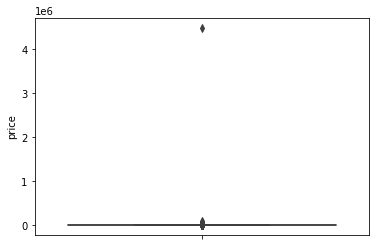

In [ ]:
import seaborn as sns
sns.boxplot(y='price', data=test)

In [ ]:
test.sort_values (by='price', ascending=False).head(98)

,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,num_features,num_photos,created_day,created_hour,rooms_price,are_animals_allowed
2864,1.0,2,cd25bbea2af848ebe9821da820b725da,2016-06-24 05:02:11,NaN,Hudson Street,"[Doorman, Elevator, Cats Allowed, Dogs Allowed...",40.7299,7208764,-74.0071,d1737922fe92ccb0dc37ba85589e6415,[],4490000,421 Hudson Street,5,1,24,5,1.496667e+06,1
9611,3.0,3,e69036ae9c8d47cbe57701d12af4dc6e,2016-05-03 02:20:32,The Towers of Waldorf Astoria Hotel offer eleg...,East 50th Street,"[Doorman, Elevator, Pre-War, Dogs Allowed, Cat...",40.7565,6955433,-73.9726,161a1a797a1e57f6ba979447a0eadf94,[https://photos.renthop.com/2/6955433_2109e252...,90000,100 East 50th Street,5,7,3,2,1.500000e+04,1
3660,3.0,3,e69036ae9c8d47cbe57701d12af4dc6e,2016-04-04 02:10:12,The Towers of Waldorf Astoria Hotel offer eleg...,East 50th Street,"[Doorman, Elevator, Furnished, Pre-War, Dogs A...",40.7565,6820053,-73.9726,c23e16813063cb363bdd2904bd20d2d0,[https://photos.renthop.com/2/6820053_1feb8e2a...,80000,100 East 50th Street,6,6,4,2,1.333333e+04,1
7473,1.0,3,a58c1c98fb50163bdc8abe3137caaffe,2016-06-29 05:48:21,TERRIFIC?LARGE?THREE?BEDROOM?RIGHT?ON?SECOND?A...,2nd Ave.,[Hardwood Floors],40.7296,7232177,-73.9872,d2bce61e0e0079ebdc8c281e415e045b,[https://photos.renthop.com/2/7232177_cbe30a21...,58020,151 2nd Ave.,1,5,29,5,1.450500e+04,0
4366,5.0,4,faa3b5d0d2bfbe54fbf4d4d15f7de59f,2016-05-25 02:43:04,Sitting in Mid Town East with a mix of Tribeca...,E 51 Street,"[Fireplace, Terrace, Dishwasher, Hardwood Floo...",40.7548,7063011,-73.9659,678c7c255c4cf0115d2200d0b6b97804,[https://photos.renthop.com/2/7063011_2faef27e...,48500,351 E 51 Street,5,8,25,2,5.388889e+03,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583,2.0,3,9fff5dca9d9a57bc32d9ae17ad38882e,2016-04-28 03:06:54,THIS NO FEE!!! 3 BED 2 BATH IS BOASTING WITH A...,Amsterdam Avenue,"[Roof Deck, Doorman, Elevator, Fitness Center,...",40.7760,6936158,-73.9839,92aa3b535f48ec05903a3b7fcdafd411,[https://photos.renthop.com/2/6936158_ecdbf863...,13300,170 Amsterdam Avenue,10,9,28,3,2.660000e+03,1
5674,2.5,3,0,2016-06-09 03:57:25,NO FEE + 1 MONTH FREE ON A 12 MONTH LEASEFULL ...,West 77th,"[Roof Deck, Doorman, Elevator, Fitness Center,...",40.7825,7130575,-73.9803,4913ac58ea40e1811820087ddb28504c,[https://photos.renthop.com/2/7130575_b60e6d61...,13300,227 West 77th,8,1,9,3,2.418182e+03,0
7676,2.0,3,009f494b0636f32b96b41926ec7c4bf2,2016-05-26 01:41:20,NaN,East 92nd Street,"[Cats Allowed, Dogs Allowed]",40.7826,7068307,-73.9509,62b685cc0d876c3a1a51d63a0d6a8082,[],13250,205 East 92nd Street,2,1,26,1,2.650000e+03,1
1368,2.0,2,51591916a346a935268552c52186932f,2016-04-08 05:57:29,Be the first to live in this extraordinary apa...,W 64th St.,"[Swimming Pool, Roof Deck, Dining Room, Doorma...",40.7716,6844925,-73.9812,2ce4ad2a77bc8190427196ea1e8cfe4e,[https://photos.renthop.com/2/6844925_acc53926...,13000,20 W 64th St.,13,5,8,5,3.250000e+03,0


In [ ]:
left_outliers = np.percentile(train['latitude'], 0.5)
right_outliers = np.percentile(train['latitude'], 99.5)

test['latitude'].loc[test['latitude'] > right_outliers] = right_outliers
test['latitude'].loc[test['latitude'] < left_outliers] = left_outliers

#Longitude выбросы
left_outliers = np.percentile(train['longitude'], 0.5)
right_outliers = np.percentile(train['longitude'], 99.5)

test['longitude'].loc[test['longitude'] > right_outliers] = right_outliers
test['longitude'].loc[test['longitude'] < left_outliers] = left_outliers

C:\Users\nikit\anaconda3\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
C:\Users\nikit\anaconda3\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
C:\Users\nikit\anaconda3\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

In [ ]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
test['manager_id'] = le.fit_transform(test['manager_id'])
test['street_address'] = test['street_address'].apply(lambda x: str(x))
test['street_address'] = le.fit_transform(test['street_address'])

In [ ]:
test.drop(test.columns.difference(['bathrooms','bedrooms', 'latitude',
                                     'longitude','manager_id','price','street_address',
                                    'rooms_price','are_animals_allowed',
                                   'created_hour','created_day','num_features',
                                    'num_photos']), 1, inplace=True)

In [ ]:
target='interest_level'
features=['bathrooms','bedrooms', 'latitude',
                                     'longitude','manager_id','price','street_address',
                                    'rooms_price','are_animals_allowed',
                                   'created_hour','created_day','num_features',
                                    'num_photos']

In [ ]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=3, random_state=42).fit(test)
cluster = pd.DataFrame(data=kmeans.labels_, columns=['cluster'])
test['cluster']=cluster['cluster']

In [ ]:
model = XGBClassifier(objective="multi:softprob", random_state=7,n_estimators = 400,
                                    subsample = 0.8,  min_child_weight = 1, max_depth=3)
model.fit(X_train, Y_train)

C:\Users\nikit\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:31:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=400, n_jobs=8, num_parallel_tree=1,
              objective='multi:softprob', random_state=7, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=0.8,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [ ]:
model = RandomForestClassifier(min_samples_leaf = 2, max_depth = None)
model.fit(X_train, Y_train)

RandomForestClassifier(min_samples_leaf=2)

In [ ]:
test[target]=model.predict(test[features])

In [ ]:
test[target].value_counts()

0    7272
1    1795
2     804
Name: interest_level, dtype: int64

In [ ]:
test['listing_id']=Id

In [ ]:
test[['listing_id', 'interest_level']] 

,listing_id,interest_level
0,7077863,0
1,7089371,1
2,7210791,0
3,6817348,0
4,7149366,0
...,...,...
9866,7143204,1
9867,7102724,0
9868,7137595,0
9869,6921832,0


In [ ]:
test[['listing_id', target]].to_csv('sub_baseline.csv', index=None)

In [ ]:
submission = pd.read_csv('sub_baseline.csv')

In [ ]:
submission

,listing_id,interest_level
0,7077863,0
1,7089371,1
2,7210791,0
3,6817348,0
4,7149366,0
...,...,...
9866,7143204,1
9867,7102724,0
9868,7137595,0
9869,6921832,0


 <img src='https://i.gifer.com/Xbb1.gif'><br>